In [7]:
from sklearn.feature_extraction.text import CountVectorizer,TfidfVectorizer

In [12]:
import os

In [10]:
tonumeric_ifdf = TfidfVectorizer()
tonumeric_ifdf

TfidfVectorizer()

In [11]:
tonumeric = CountVectorizer()
tonumeric

CountVectorizer()

In [18]:
os.getcwd()

'C:\\Users\\modza\\Documents\\nlp'

In [21]:
os.listdir()

['.ipynb_checkpoints',
 '1. Text Classification - SMS.ipynb',
 'DataScraping_NER_SentimentAnalysis.ipynb',
 'DocumentSimilarityClustering_v1.ipynb',
 'env',
 'Face_recog.ipynb',
 'flagged',
 'Practice_stemandlem.ipynb',
 'sms.tsv',
 'Stemming _ Lemmatization using NLTK.ipynb',
 'stemmingLemmatization.ipynb',
 'textAnalytics.ipynb',
 'Untitled.ipynb',
 'Untitled1.ipynb',
 'Using spaCy.ipynb',
 'yelp.csv']

In [24]:
os.open('sms.tsv',flags = Os.read )

NameError: name 'Os' is not defined

In [25]:
import pandas as pd

pd.read_csv('sms.tsv',sep="\t")

## Count Vectorizer

In [30]:
from sklearn.neighbors import KNeighborsClassifier

In [29]:
tonumeric = CountVectorizer()
tonumeric

CountVectorizer()

In [ ]:
pd.read_csv('sms.tsv',sep="\t")

In [31]:
sampletrain = ['i will call you tonight','please help me','please call a cab please']

In [32]:
#sample target vector
y = [0,1,0]

In [33]:
#to convert text data to numerical

from sklearn.feature_extraction.text import CountVectorizer
tonumeric = CountVectorizer()

In [34]:
#create the vocabulary from data

tonumeric.fit(sampletrain)

CountVectorizer()

In [40]:
sampletrain

['i will call you tonight', 'please help me', 'please call a cab please']

In [39]:
tonumeric.get_feature_names_out().tolist()

['cab', 'call', 'help', 'me', 'please', 'tonight', 'will', 'you']

In [37]:
len(tonumeric.get_feature_names_out())

8

In [41]:
#Convert the extracted vocabulary to documnt term matrix


sampletrain_dtm = tonumeric.transform(sampletrain)
sampletrain_dtm

<3x8 sparse matrix of type '<class 'numpy.int64'>'
	with 10 stored elements in Compressed Sparse Row format>

In [42]:
sampletrain_dtm.toarray()

array([[0, 1, 0, 0, 0, 1, 1, 1],
       [0, 0, 1, 1, 1, 0, 0, 0],
       [1, 1, 0, 0, 2, 0, 0, 0]], dtype=int64)

In [43]:
pd.DataFrame(sampletrain_dtm.toarray(),columns = tonumeric.get_feature_names_out())

,cab,call,help,me,please,tonight,will,you
0,0,1,0,0,0,1,1,1
1,0,0,1,1,1,0,0,0
2,1,1,0,0,2,0,0,0


In [44]:
#Build a model to precit the target


knn = KNeighborsClassifier(n_neighbors=1)
knn.fit(sampletrain_dtm,y)

KNeighborsClassifier(n_neighbors=1)

In [45]:
sampletest = ["Don't call please"]

In [46]:
sampletest_dtm = tonumeric.transform(sampletest)
sampletest_dtm

<1x8 sparse matrix of type '<class 'numpy.int64'>'
	with 2 stored elements in Compressed Sparse Row format>

In [47]:
sampletest_dtm.toarray()

array([[0, 1, 0, 0, 1, 0, 0, 0]], dtype=int64)

In [48]:
knn.predict(sampletest_dtm)

array([0])

### 
* vect.fit(sampletrain) ----learn the vocabulary from training data
* vect.get_feature_names_out() --- displays the vocabulary
* vect.transform(sampletrain) ---- use the trained vocabulary to build DTM from the trained data
* vect.transform(sampletest) --- use the trained vocabulary to build a DTM from the testdata and ignre vocabulary it hasn't seen before

### SMS Data

In [77]:
data = pd.read_csv('sms.tsv',sep="\t",names = ['label','message'])
data

,label,message
0,ham,"Go until jurong point, crazy.. Available only ..."
1,ham,Ok lar... Joking wif u oni...
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...
3,ham,U dun say so early hor... U c already then say...
4,ham,"Nah I don't think he goes to usf, he lives aro..."
...,...,...
5567,spam,This is the 2nd time we have tried 2 contact u...
5568,ham,Will ü b going to esplanade fr home?
5569,ham,"Pity, * was in mood for that. So...any other s..."
5570,ham,The guy did some bitching but I acted like i'd...


In [78]:
data.shape

(5572, 2)

In [79]:
data['label_name'] = data.label.map({'ham':0,'spam':1})

In [80]:
data.head()

,label,message,label_name
0,ham,"Go until jurong point, crazy.. Available only ...",0
1,ham,Ok lar... Joking wif u oni...,0
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...,1
3,ham,U dun say so early hor... U c already then say...,0
4,ham,"Nah I don't think he goes to usf, he lives aro...",0


In [55]:
data.label.value_counts()

label
ham     4825
spam     747
Name: count, dtype: int64

In [81]:
# X and Y features

X = data["message"]

y = data['label_name']


print(X.shape)
print(y.shape)

(5572,)
(5572,)


In [61]:
from sklearn.model_selection import train_test_split

In [62]:
X_train,X_test,y_train,y_test = train_test_split(X,y,random_state = 7)

###  applying count vectorizer

## 
1. use X_train data to create vocabulary
2. with created vocabulary , get DTM for X_train
3. with created vocabulary(using X_train_data), get DTM for X_test

In [ ]:
tonumeric.fit(X_train)

In [65]:
Xtrain_dtm = tonumeric.transform(X_train)
Xtrain_dtm

<4179x7535 sparse matrix of type '<class 'numpy.int64'>'
	with 56144 stored elements in Compressed Sparse Row format>

tonumeric.get_feature_names_out().tolist()

In [77]:
Xtest_dtm = tonumeric.transform(X_test)
Xtest_dtm

<1393x7535 sparse matrix of type '<class 'numpy.int64'>'
	with 16754 stored elements in Compressed Sparse Row format>

# 4. Build a model

In [67]:
from sklearn.naive_bayes import MultinomialNB

nb = MultinomialNB()

In [68]:
nb.fit(Xtrain_dtm,y_train)

MultinomialNB()

In [78]:
y_pred = nb.predict(Xtest_dtm)

In [73]:
from sklearn import metrics

In [79]:
Xtest_dtm.shape

(1393, 7535)

In [80]:
print(y_test.shape)

(1393,)


In [81]:
metrics.accuracy_score(y_test,y_pred)

0.9820531227566404

In [82]:
metrics.confusion_matrix(y_test,y_pred)

array([[1194,    7],
       [  18,  174]], dtype=int64)

In [83]:
nb.score(Xtest_dtm,y_test)       #checking accuracy using model function

0.9820531227566404

# 5.  Compare multiple models

In [84]:
from sklearn.linear_model import LogisticRegression

lr = LogisticRegression()
lr

LogisticRegression()

In [85]:
lr.fit(Xtrain_dtm,y_train)

LogisticRegression()

In [86]:
lr_pred = lr.predict(Xtest_dtm)


In [87]:
lr.score(Xtest_dtm,y_test)

0.9798994974874372

In [88]:
metrics.accuracy_score(y_test,lr_pred)

0.9798994974874372

In [96]:
prob = lr.predict_proba(Xtest_dtm)[:,1]

In [97]:
metrics.roc_auc_score(y_test,prob)

0.9951819664168748

# TF-IDF Vectorizer

In [98]:
tonumeric_tfidf = TfidfVectorizer()
tonumeric_tfidf

TfidfVectorizer()

In [102]:
tonumeric_tfidf.fit(sampletrain)

TfidfVectorizer()

In [103]:
tonumeric_tfidf.get_feature_names_out().tolist()

['cab', 'call', 'help', 'me', 'please', 'tonight', 'will', 'you']

In [99]:
tonumeric_tfidf.fit(X_train)

TfidfVectorizer()

In [101]:
tonumeric_tfidf.get_feature_names_out().tolist()

['00',
 '000',
 '000pes',
 '008704050406',
 '0089',
 '0121',
 '01223585236',
 '0125698789',
 '02',
 '0207',
 '02072069400',
 '02073162414',
 '02085076972',
 '021',
 '03',
 '04',
 '0430',
 '05',
 '050703',
 '0578',
 '06',
 '07',
 '07046744435',
 '07090201529',
 '07090298926',
 '07099833605',
 '07123456789',
 '0721072',
 '07732584351',
 '07734396839',
 '07742676969',
 '07753741225',
 '0776xxxxxxx',
 '07781482378',
 '07786200117',
 '077xxx',
 '07801543489',
 '07808726822',
 '07821230901',
 '07880867867',
 '07946746291',
 '07973788240',
 '07xxxxxxxxx',
 '08',
 '0800',
 '08000407165',
 '08000776320',
 '08000839402',
 '08000930705',
 '08000938767',
 '08001950382',
 '08002888812',
 '08002986030',
 '08002986906',
 '08002988890',
 '08006344447',
 '0808',
 '08081263000',
 '08081560665',
 '0825',
 '083',
 '0844',
 '0845',
 '08452810071',
 '08452810073',
 '0870',
 '08700469649',
 '08700621170150p',
 '08701213186',
 '08701237397',
 '08701417012',
 '08701417012150p',
 '087016248',
 '087018728737',
 

# 6. Fine tune vectorizer

In [57]:
from spacy.lang.en import stop_words

In [60]:
stop_words.STOP_WORDS

{"'d",
 "'ll",
 "'m",
 "'re",
 "'s",
 "'ve",
 'a',
 'about',
 'above',
 'across',
 'after',
 'afterwards',
 'again',
 'against',
 'all',
 'almost',
 'alone',
 'along',
 'already',
 'also',
 'although',
 'always',
 'am',
 'among',
 'amongst',
 'amount',
 'an',
 'and',
 'another',
 'any',
 'anyhow',
 'anyone',
 'anything',
 'anyway',
 'anywhere',
 'are',
 'around',
 'as',
 'at',
 'back',
 'be',
 'became',
 'because',
 'become',
 'becomes',
 'becoming',
 'been',
 'before',
 'beforehand',
 'behind',
 'being',
 'below',
 'beside',
 'besides',
 'between',
 'beyond',
 'both',
 'bottom',
 'but',
 'by',
 'ca',
 'call',
 'can',
 'cannot',
 'could',
 'did',
 'do',
 'does',
 'doing',
 'done',
 'down',
 'due',
 'during',
 'each',
 'eight',
 'either',
 'eleven',
 'else',
 'elsewhere',
 'empty',
 'enough',
 'even',
 'ever',
 'every',
 'everyone',
 'everything',
 'everywhere',
 'except',
 'few',
 'fifteen',
 'fifty',
 'first',
 'five',
 'for',
 'former',
 'formerly',
 'forty',
 'four',
 'from',
 'fron

In [62]:
CountVectorizer(stop_words='english')

CountVectorizer(stop_words='english')

In [63]:
TfidfVectorizer(stop_words='english')

TfidfVectorizer(stop_words='english')

In [54]:

from sklearn.feature_extraction.text import TfidfVectorizer
from spacy.lang.de.stop_words import STOP_WORDS      # stopwords for german


tfidf_text_vectorizer = TfidfVectorizer(stop_words=list(STOP_WORDS))
tfidf_text_vectorizer 

TfidfVectorizer(stop_words=['oben', 'deine', 'siebten', 'wann', 'ins', 'könnt',
                            'dritte', 'ihrer', 'viele', 'gehen', 'muss',
                            'erster', 'gedurft', 'derselbe', 'acht', 'gemusst',
                            'grossen', 'eigener', 'zurück', 'sieben', 'deshalb',
                            'neuntes', 'zunächst', 'drei', 'geht', 'unser',
                            'hatten', 'zweiten', 'jeder', 'jede', ...])

In [71]:
TfidfVectorizer(stop_words={'english'})

TfidfVectorizer(stop_words={'english'})

In [72]:
tonumeric = TfidfVectorizer(stop_words={'english'})
#tonumeric.fit(X_train)
#len(tonumeric.get_feature_names_out())

In [86]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Assuming you have defined X_train
vectorizer = TfidfVectorizer()
vectorizer.fit_transform(X_train)

len(vectorizer.get_feature_names_out())

7535

In [87]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Assuming you have defined X_train
vectorizer = TfidfVectorizer(stop_words='english')
vectorizer.fit_transform(X_train)

len(vectorizer.get_feature_names_out())

7271

In [89]:
vectorizer.get_feature_names_out()[-10:]

array(['zeros', 'zhong', 'zindgi', 'zoe', 'zogtorius', 'zoom', 'zouk',
       'zyada', 'èn', 'ú1'], dtype=object)

In [90]:
vectorizer = TfidfVectorizer(ngram_range = (1,2))
vectorizer.fit(X_train)
len(vectorizer.get_feature_names_out())

41571

In [94]:
vectorizer = TfidfVectorizer(max_df = 0.05)
vectorizer.fit(X_train)
len(vectorizer.get_feature_names_out())

7495

# 7. Word Cloud

In [96]:
!pip install wordcloud

   ---------------------------------------- 0.0/300.2 kB ? eta -:--:--
   ---------------------------------------- 0.0/300.2 kB ? eta -:--:--
   - -------------------------------------- 10.2/300.2 kB ? eta -:--:--
   - -------------------------------------- 10.2/300.2 kB ? eta -:--:--
   --- ----------------------------------- 30.7/300.2 kB 163.8 kB/s eta 0:00:02
   ----- --------------------------------- 41.0/300.2 kB 196.9 kB/s eta 0:00:02
   ----------- --------------------------- 92.2/300.2 kB 375.8 kB/s eta 0:00:01
   ---------------------- --------------- 174.1/300.2 kB 618.3 kB/s eta 0:00:01
   ---------------------------- --------- 225.3/300.2 kB 689.2 kB/s eta 0:00:01
   -------------------------------------- 300.2/300.2 kB 807.6 kB/s eta 0:00:00


In [97]:
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

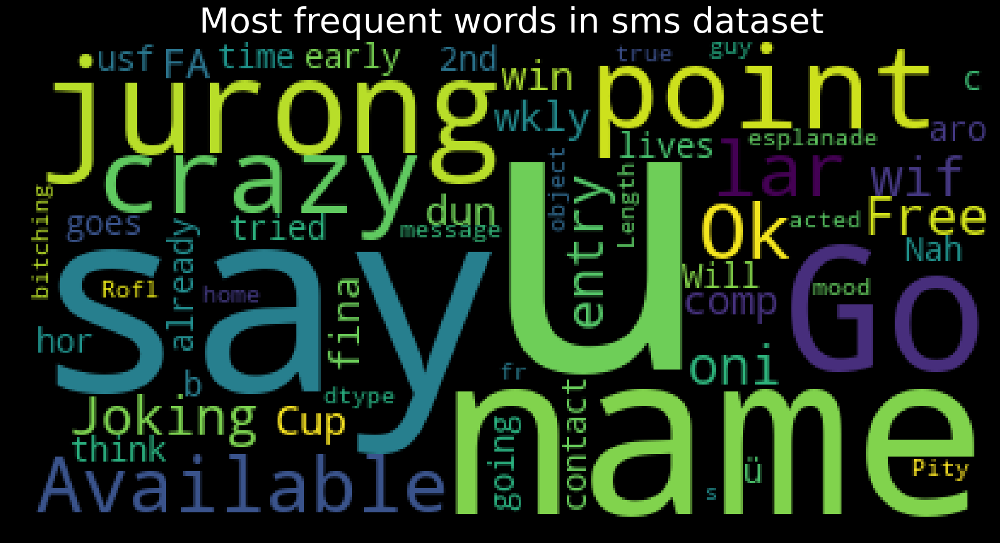

In [102]:
wc= WordCloud()
wc.generate(str(data['message']))
plt.figure(figsize = (20,10), facecolor = 'k')
plt.title('Most frequent words in sms dataset', fontsize  = 40,color = 'white')
plt.imshow(wc)
plt.show()

# 8. Stemming and lemmatization

In [103]:
import nltk

In [104]:
from nltk.stem import PorterStemmer
from nltk.stem import LancasterStemmer

In [105]:
porter = PorterStemmer()
lancaster = LancasterStemmer()

In [106]:
data['message'].iloc[0]

'Go until jurong point, crazy.. Available only in bugis n great world la e buffet... Cine there got amore wat...'

In [108]:
from nltk.tokenize import sent_tokenize, word_tokenize
def stemsentence(sentence):
    tokenwords = word_tokenize(sentence)
    tokenwords
    stem_sentence = []
    for word in tokenwords:
        stem_sentence.append(porter.stem(word))
        stem_sentence.append(" ")
    return "".join(stem_sentence)

x = stemsentence('Go until jurong point, crazy.. Available only in bugis n great world la e buffet... Cine there got amore wat...')
print(x)
        

go until jurong point , crazi .. avail onli in bugi n great world la e buffet ... cine there got amor wat ... 


#  9. Sentiment Analysis

In [109]:
from textblob import TextBlob

In [110]:
text = "I hate anything that goes in my ear"

In [111]:
result = TextBlob(text)


In [112]:
result.sentiment.polarity

-0.8

In [100]:
data['message'].iloc[0]

'Go until jurong point, crazy.. Available only in bugis n great world la e buffet... Cine there got amore wat...'

In [2]:
import pandas as pd

In [3]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import train_test_split

In [4]:
from sklearn.naive_bayes import MultinomialNB
from sklearn import metrics
from sklearn.linear_model import LogisticRegression

In [6]:
df = pd.read_csv('sms.tsv', sep = "\t",names = ['type','sms'])
df.head()

,type,sms
0,ham,"Go until jurong point, crazy.. Available only ..."
1,ham,Ok lar... Joking wif u oni...
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...
3,ham,U dun say so early hor... U c already then say...
4,ham,"Nah I don't think he goes to usf, he lives aro..."


In [7]:
df['label'] = df.type.map({'ham':0,'spam':1})

In [8]:
df.head()

,type,sms,label
0,ham,"Go until jurong point, crazy.. Available only ...",0
1,ham,Ok lar... Joking wif u oni...,0
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...,1
3,ham,U dun say so early hor... U c already then say...,0
4,ham,"Nah I don't think he goes to usf, he lives aro...",0


In [10]:
#split the dataset in training and test
X = df['sms']
y = df['label']

X_train,X_test,y_train,y_test = train_test_split(X,y,random_state=7)



In [11]:
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(4179,)
(1393,)
(4179,)
(1393,)


In [13]:
#Text to numeric Conversion


tonumeric = CountVectorizer()
tonumeric

CountVectorizer()

In [14]:
tonumeric_tf = TfidfVectorizer()
tonumeric_tf

TfidfVectorizer()

In [20]:
#DTM (Document Term Matrix Construaction) ----- Matrix containing words as feature


Xtrain = tonumeric.fit(X_train)
Xtrain

CountVectorizer()

In [22]:
Xtrain.get_feature_names_out()

array(['00', '000', '000pes', ..., 'zyada', 'èn', 'ú1'], dtype=object)

In [23]:
Xtrain_dtm = tonumeric.transform(X_train)
Xtrain_dtm

<4179x7535 sparse matrix of type '<class 'numpy.int64'>'
	with 56144 stored elements in Compressed Sparse Row format>

In [25]:
Xtest_dtm = tonumeric.transform(X_test)
Xtest_dtm

<1393x7535 sparse matrix of type '<class 'numpy.int64'>'
	with 16754 stored elements in Compressed Sparse Row format>

In [26]:
nb = MultinomialNB()
nb

MultinomialNB()

In [29]:
nb.fit(Xtrain_dtm,y_train)

MultinomialNB()

In [30]:
nb.predict(Xtest_dtm)

array([0, 0, 0, ..., 1, 0, 0], dtype=int64)

In [32]:
metrics.accuracy_score(y_test,nb.predict(Xtest_dtm))

0.9820531227566404

In [34]:
metrics.confusion_matrix(y_test,nb.predict(Xtest_dtm))

array([[1194,    7],
       [  18,  174]], dtype=int64)

# OCR

In [1]:
!pip install pytesseract

In [2]:
!pip install Pillow

In [1]:
import pytesseract
from PIL import Image

In [2]:
image = Image.open('C:\\users\\modza\\downloads\\WhatsApp Image 2024-01-27 at 18.16.41_f21f9f27.jpg')

import os
os.environ['TESSDATA_PREFIX'] = ''


In [3]:
a = Image.open('C:\\users\\modza\\downloads\\a.jpg')

In [4]:
pytesseract.pytesseract.tesseract_cmd = 'C:/Program Files (x86)/Tesseract-OCR/tesseract.exe'

In [5]:
pytesseract

<module 'pytesseract' from 'C:\\Users\\modza\\Documents\\nlp\\env\\Lib\\site-packages\\pytesseract\\__init__.py'>

In [5]:
#pytesseract.pytesseract.tesseract_cmd = "C:\Program Files (x86)\Tesseract-OCR"
tessdata_dir_config = '--tessdata-dir "C:/Program Files (x86)/Tesseract-OCR/tessdata"'
pytesseract.pytesseract.tesseract_cmd = 'C:/Program Files (x86)/Tesseract-OCR/tesseract.exe'
ad = pytesseract.image_to_string(a,config=tessdata_dir_config)

In [7]:
# Replace line breaks with an empty string
ad.replace("\n", "")


'LargeCaps Watchlist 5 MW 6Q Search & addSTYLAMINDEVENT -32.55 (-1.96%)GUFICBIO 349.65+2.75 (+0.79%)RSYSTEMSMANALIPETCNEWGEN+35.70 (+4.32%)POLYPLEXBSE -16.30 (-1.59%)INFOBEANNSE-6.85 (-1.63%)PRINCEPIPE689.55= BSE_ BORORENEW'

In [6]:
ad.lower()

'largecaps watchlist 5 mw 6\nq search & add\n\nstylamind\n\nevent -32.55 (-1.96%)\n\nguficbio 349.65\n\n+2.75 (+0.79%)\n\nrsystems\n\nmanalipetc\n\nnewgen\n+35.70 (+4.32%)\n\npolyplex\n\nbse -16.30 (-1.59%)\n\ninfobean\nnse\n\n-6.85 (-1.63%)\n\nprincepipe\n\n689.55\n= bse\n\n_ bororenew\n\n'

In [8]:
import spacy

# Load English tokenizer, tagger, parser, NER, and word vectors
nlp = spacy.load("en_core_web_sm")

# Your text
#text = "Apple is looking at buying U.K. startup for $1 billion"

# Process the text
doc = nlp(ad.replace("\n",''))

# Iterate over the predicted entities
for ent in doc.ents:
    print(ent.text, ent.label_)


5 CARDINAL
MW ORG
Search & addSTYLAMINDEVENT -32.55 ORG
BSE ORG


from IPython.display import Image, display

# Display the image
display(a)

In [23]:
pytesseract.image_to_string(a, config=tessdata_dir_config)

'LargeCaps Watchlist 5 MW 6\nQ Search & add\n\nSTYLAMIND\n\nEVENT -32.55 (-1.96%)\n\nGUFICBIO 349.65\n\n+2.75 (+0.79%)\n\nRSYSTEMS\n\nMANALIPETC\n\nNEWGEN\n+35.70 (+4.32%)\n\nPOLYPLEX\n\nBSE -16.30 (-1.59%)\n\nINFOBEAN\nNSE\n\n-6.85 (-1.63%)\n\nPRINCEPIPE\n\n689.55\n= BSE\n\n_ BORORENEW\n\n'

Detected text: LargeCaps (Confidence: 92%) at position (141, 30) with width 145 and height 30
Detected text: Watchlist (Confidence: 95%) at position (364, 28) with width 125 and height 25
Detected text: 5 (Confidence: 96%) at position (500, 28) with width 14 and height 23
Detected text: MW (Confidence: 96%) at position (595, 27) with width 52 and height 23
Detected text: 6 (Confidence: 96%) at position (657, 27) with width 15 and height 23
Detected text: Q (Confidence: 71%) at position (117, 94) with width 34 and height 33
Detected text: Search (Confidence: 71%) at position (187, 100) with width 113 and height 22
Detected text: & (Confidence: 93%) at position (290, 90) with width 15 and height 41
Detected text: add (Confidence: 96%) at position (325, 103) with width 39 and height 18
Detected text: STYLAMIND (Confidence: 91%) at position (99, 239) with width 164 and height 22
Detected text: EVENT (Confidence: 96%) at position (164, 291) with width 76 and height 19
Detected text: -32.55 

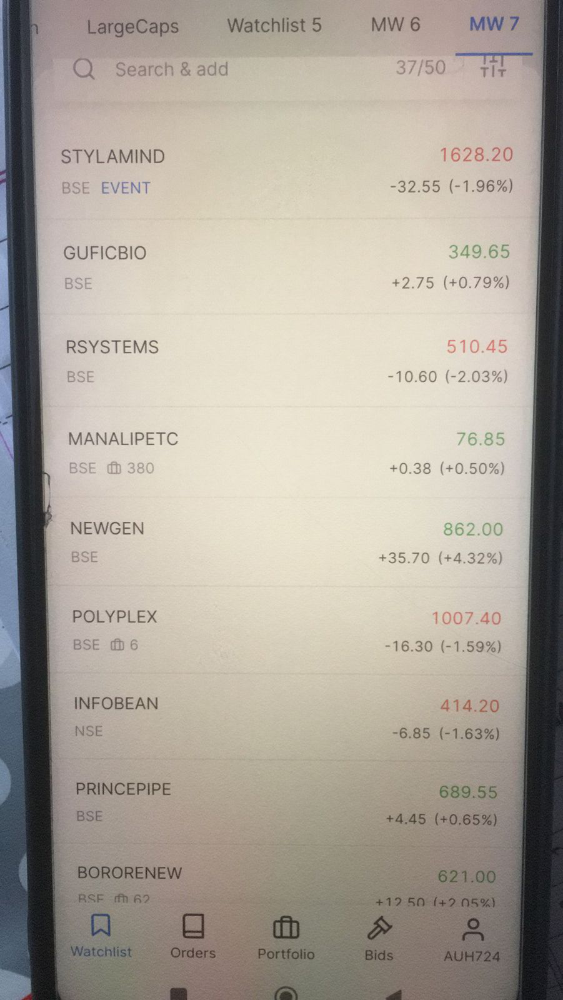

In [25]:
# Perform OCR on the image, getting detailed data
data = pytesseract.image_to_data(a, lang='eng', config=tessdata_dir_config, output_type=pytesseract.Output.DICT)

# The 'data' variable is a dictionary that contains the OCR results, including the text, confidences,
# and positions of the bounding boxes. You can iterate over this data as follows:

n_boxes = len(data['text'])
for i in range(n_boxes):
    if int(data['conf'][i]) > 60:  # Confidence threshold.
        (x, y, w, h) = (data['left'][i], data['top'][i], data['width'][i], data['height'][i])
        text = data['text'][i]
        print(f"Detected text: {text} (Confidence: {data['conf'][i]}%) at position ({x}, {y}) with width {w} and height {h}")
display(a)

pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract.exe'

In [27]:
!pip install pdf2image

In [9]:
from pdf2image import convert_from_path

In [16]:
Image(<PIL.PpmImagePlugin.PpmImageFile image mode=RGB size=1245x2200>)

SyntaxError: invalid decimal literal (481782852.py, line 1)

In [14]:
display('<PIL.PpmImagePlugin.PpmImageFile image mode=RGB size=1245x2200>')

'<PIL.PpmImagePlugin.PpmImageFile image mode=RGB size=1245x2200>'

In [17]:
ad = convert_from_path('Whiteboard 28 Jan 2024.pdf', poppler_path = poppler_path)

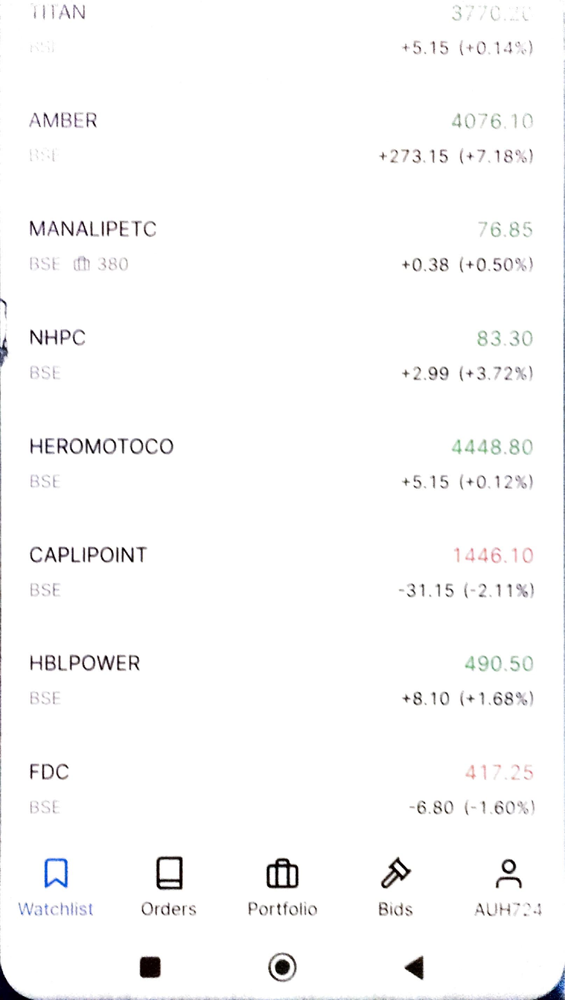

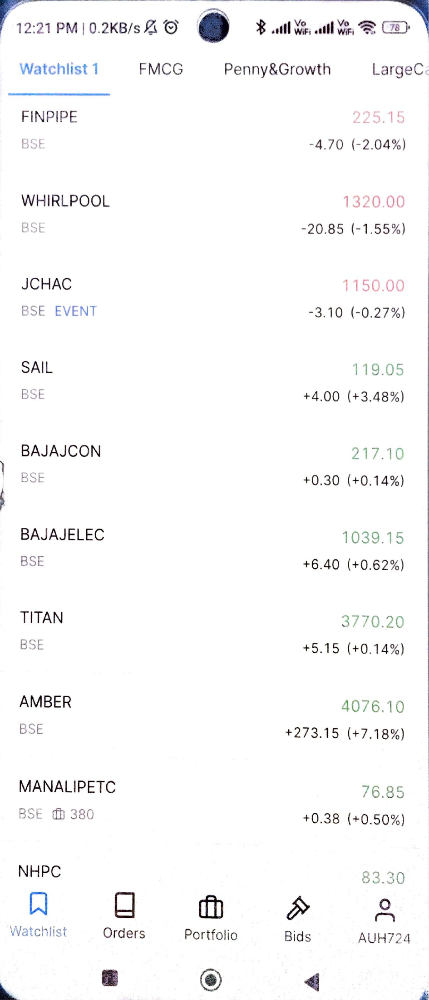

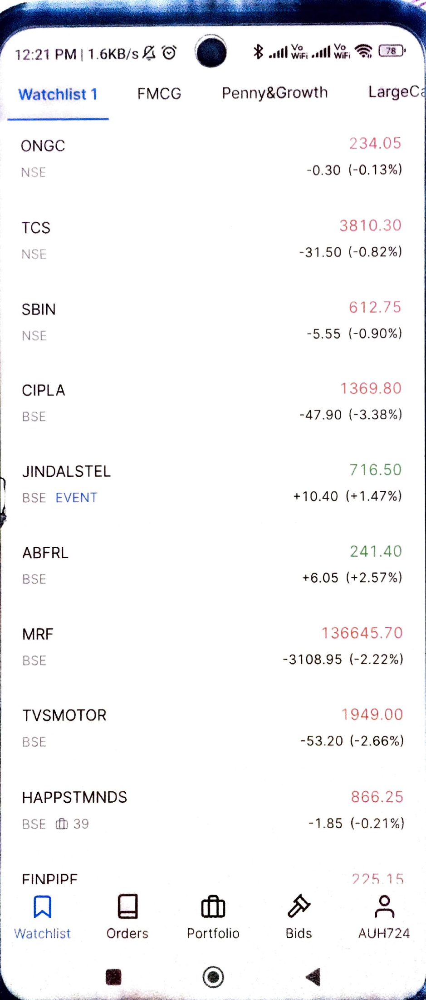

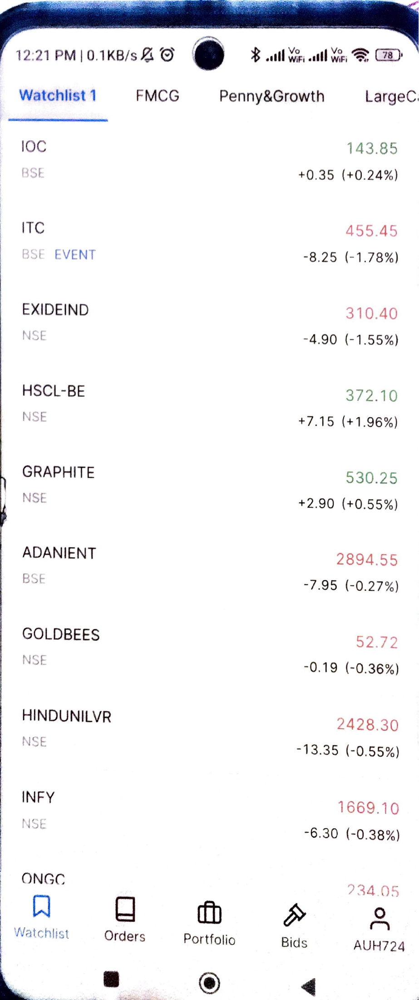

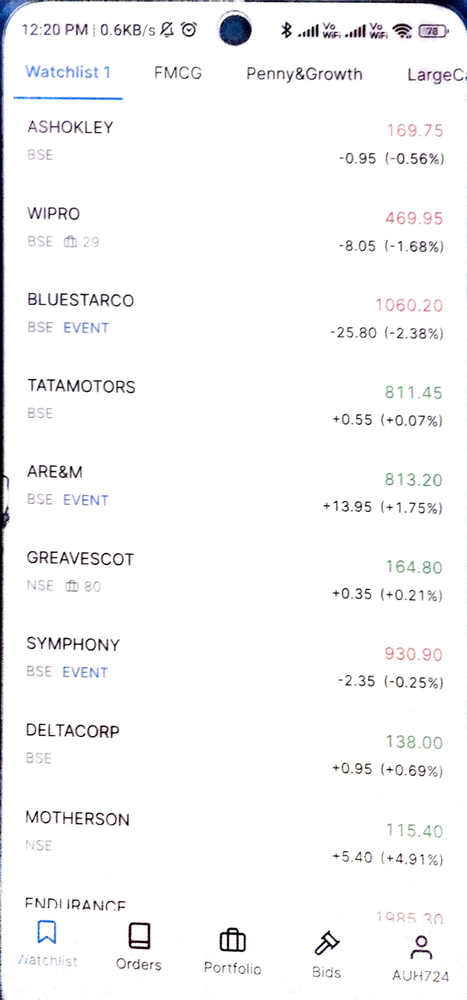

...

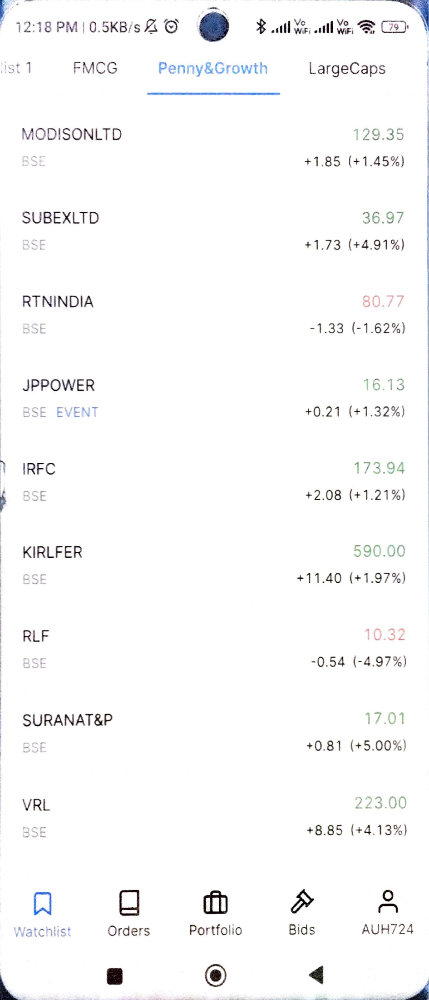

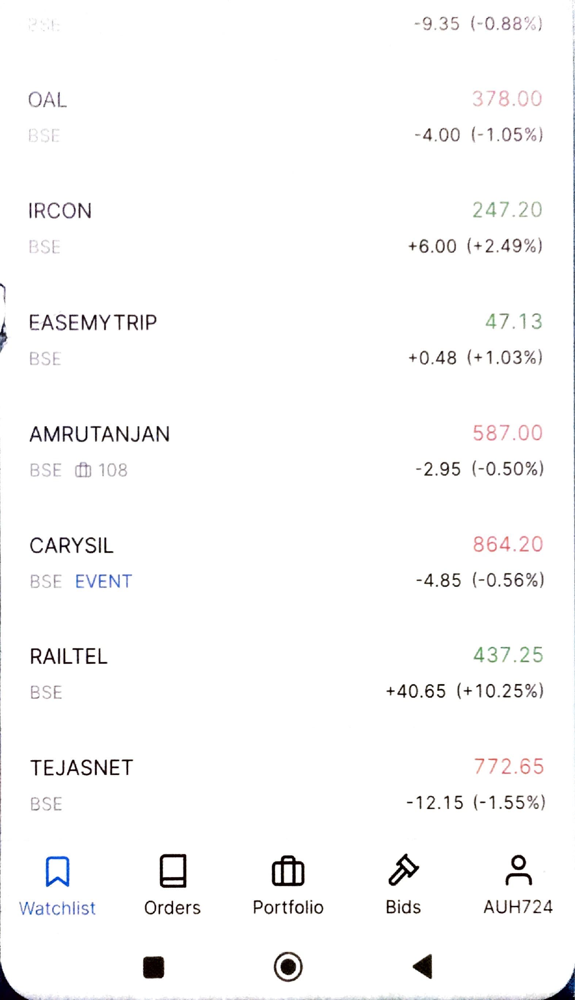

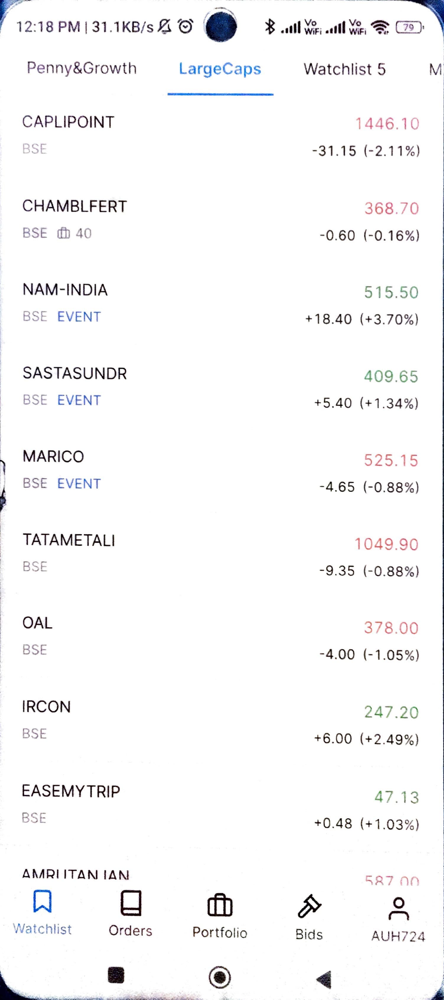

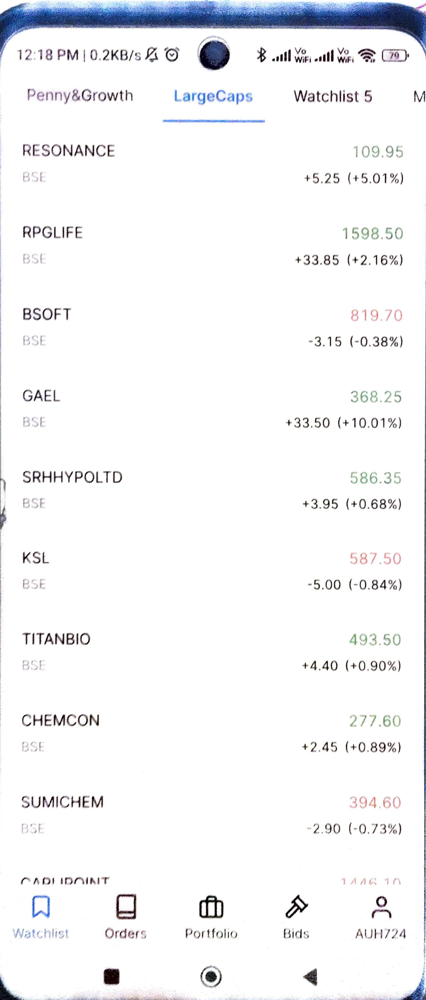

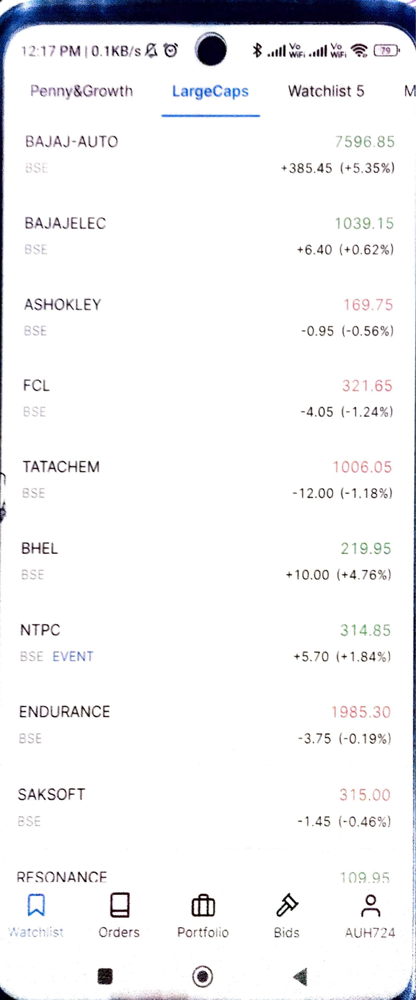

In [18]:
from IPython.display import display

# Assuming 'images' is the list of PIL image objects you have
#images = [
    # ... your list of PIL image objects
#]

# Iterate over the image objects and display them
for image in ad:
    display(image)


In [19]:
import os
from pdf2image import convert_from_path
#import pytesseract
from IPython.display import display
from PIL import Image

# Ensure the path to Tesseract is set in the environment if not already set
# pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract.exe'  # Update the path if necessary

# Path to the PDF file
pdf_path = 'Whiteboard 28 Jan 2024.pdf'

# Use pdf2image to convert each page of the PDF to an image
pages = convert_from_path(pdf_path, 600,poppler_path = poppler_path)  # 300 is the dpi (resolution)

# Loop over each page/image and perform OCR
for i, page in enumerate(pages):
    text = pytesseract.image_to_string(page, lang='eng',config=tessdata_dir_config)  # Use the appropriate language code
    print(f"Text from page {i+1}:\n{text}\n")
    # Optionally display the image
    # display(page)
    
    # Save each page as an image file if needed
    # page.save(f'page_{i+1}.jpg', 'JPEG')


Text from page 1:
AMBER

MANALIPETC

HEROMOTOCO

a \. }
Mot

CAPLIPOINT

RSI

HBLPOWER

RC]
‘ ’ i

FDC

A a

Orders

,
4
x

5.15 (40.14%)

AO76.70

$273.15 (+7.18%)

: ‘ .
6.85

+0.38 (+0.50%)

| 5 ; ™ ,
rSao. i

-31.15 (-2.11%)

490.50

+8.10 (+1.68%)

474
> |

-6.80 (-1.60%)

& SS

AUTH SO.



Text from page 2:
a“? — 7
2:21 PM|0.2KB/s & © ) BQ ath VS; tll Ve, S GO

Watchlist 1

FINPIPE

BSE

FMCG

WHIRLPOOL

BSI

JCHAC
BSE EVENT

SAIL

BSE

BAJAJCON

BSE

BAJAJELEC

MANALIPETC

BSE dp 380

NHPC
Watchlist Orders
fe

=

Penny&Growth

i

LargeC:

p eT 15
Ps +f

-4.70 (-2.04%)

1320.00
-20.85 (-1.55%)

1150.00
-3.10 (-0.27%)

119.05
+4.00 (+3.48%)

217.10
+0.30 (+0.14%)

1039.15
+6.40 (+0.62%)

3770.20
+5.15 (+0.14%)

4076.10

+273.15 (+7.18%)

76.85
+0.38 (+0.50%)

Portfolio

©

Bids

AUH724


Text from page 3:
oe EEE eEoo_oOoOoOoOoOoO—_—_O_OOOOOOOO Eee
eee

Watchlist 1

ONGC

[Cj

TCS

JINDALSTEL
BSE EVENT

ABFRL

TVSMOTOR
BSE

FMCG

HAPPSTMNDS

BSE (fp 39

FINPIPF

A

Watchlist

=

Or

In [8]:
poppler_path = r"C:/Users/modza/Downloads/Release-23.11.0-0/poppler-23.11.0/Library/bin"

In [20]:
import os
import pandas as pd
from pdf2image import convert_from_path
# import pytesseract
from IPython.display import display
from PIL import Image

# Ensure the path to Tesseract is set in the environment if not already set
# pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract.exe'  # Update the path if necessary

# Path to the PDF file
pdf_path = 'Whiteboard 28 Jan 2024.pdf'

# Use pdf2image to convert each page of the PDF to an image
pages = convert_from_path(pdf_path, 600, poppler_path=poppler_path)  # 300 is the dpi (resolution)

# Create a list to store data for each page
data = []

# Loop over each page/image and perform OCR
for i, page in enumerate(pages):
    text = pytesseract.image_to_string(page, lang='eng', config=tessdata_dir_config)  # Use the appropriate language code
    print(f"Text from page {i+1}:\n{text}\n")
    
    # Assuming the text is separated by a specific character like a comma, tab, etc.
    # Split the text and store it in the data list
    # Modify the split logic based on your text structure
    rows = text.split('\n')  # Splitting by newline character, change if needed
    for row in rows:
        columns = row.split('\t')  # Splitting by tab character, change if needed
        data.append(columns)

    # Optionally display the image
    # display(page)
    
    # Save each page as an image file if needed
    # page.save(f'page_{i+1}.jpg', 'JPEG')

# Convert the list to a DataFrame
df = pd.DataFrame(data)

# Remove empty rows if any
df.dropna(how='all', inplace=True)

# Export to CSV or Excel
df.to_csv('extracted_text.csv', index=False)  # Export as CSV
# df.to_excel('extracted_text.xlsx', index=False)  # Export as Excel


Text from page 1:
AMBER

MANALIPETC

HEROMOTOCO

a \. }
Mot

CAPLIPOINT

RSI

HBLPOWER

RC]
‘ ’ i

FDC

A a

Orders

,
4
x

5.15 (40.14%)

AO76.70

$273.15 (+7.18%)

: ‘ .
6.85

+0.38 (+0.50%)

| 5 ; ™ ,
rSao. i

-31.15 (-2.11%)

490.50

+8.10 (+1.68%)

474
> |

-6.80 (-1.60%)

& SS

AUTH SO.



Text from page 2:
a“? — 7
2:21 PM|0.2KB/s & © ) BQ ath VS; tll Ve, S GO

Watchlist 1

FINPIPE

BSE

FMCG

WHIRLPOOL

BSI

JCHAC
BSE EVENT

SAIL

BSE

BAJAJCON

BSE

BAJAJELEC

MANALIPETC

BSE dp 380

NHPC
Watchlist Orders
fe

=

Penny&Growth

i

LargeC:

p eT 15
Ps +f

-4.70 (-2.04%)

1320.00
-20.85 (-1.55%)

1150.00
-3.10 (-0.27%)

119.05
+4.00 (+3.48%)

217.10
+0.30 (+0.14%)

1039.15
+6.40 (+0.62%)

3770.20
+5.15 (+0.14%)

4076.10

+273.15 (+7.18%)

76.85
+0.38 (+0.50%)

Portfolio

©

Bids

AUH724


Text from page 3:
oe EEE eEoo_oOoOoOoOoOoO—_—_O_OOOOOOOO Eee
eee

Watchlist 1

ONGC

[Cj

TCS

JINDALSTEL
BSE EVENT

ABFRL

TVSMOTOR
BSE

FMCG

HAPPSTMNDS

BSE (fp 39

FINPIPF

A

Watchlist

=

Or

In [21]:
df

,0
0,AMBER
1,
2,MANALIPETC
3,
4,HEROMOTOCO
...,...
1445,Rids AUH724
1446,
1447,M
1448,
